Seguir con mas cosas del EDA de listings 

# Data Loading

In [3]:
#Import libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import geopandas as gpd
import plotly.express as px

import json

from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder

from sklearn.impute import KNNImputer

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.svm import SVR

from scipy.stats import zscore
from scipy.stats import shapiro
from scipy.stats import normaltest

import joblib

import warnings
warnings.filterwarnings('ignore')


In [4]:
#import functions

import functions as f

In [5]:
#Load the data

# calendar = pd.read_csv('calendar.csv')
# listings = pd.read_csv('listings.csv')
# reviews = pd.read_csv('reviews.csv')

listings_sum = pd.read_csv(r'data\listings_sum.csv')
# reviews_sum = pd.read_csv('reviews_sum.csv')

# neighbourhoods = pd.read_csv('neighbourhoods.csv')
# neighbourhoods_json = pd.read_json('neighbourhoods.geojson')

# data_description = pd.read_csv('Data_description.csv')


In [6]:
listings = pd.read_csv(r'data\listings.csv')


# Data cleaning and preprocessing

- Duplicates

- Data format

- Outliers

- Missing values


In [7]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9659 entries, 0 to 9658
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            9659 non-null   int64  
 1   listing_url                                   9659 non-null   object 
 2   scrape_id                                     9659 non-null   int64  
 3   last_scraped                                  9659 non-null   object 
 4   source                                        9659 non-null   object 
 5   name                                          9659 non-null   object 
 6   description                                   9310 non-null   object 
 7   neighborhood_overview                         5469 non-null   object 
 8   picture_url                                   9659 non-null   object 
 9   host_id                                       9659 non-null   i

## Duplicates

In [8]:
#Remove duplicated rows

listings.drop_duplicates(inplace=True)

## Data format

In [9]:
# Fix the price column
listings['price'] = listings['price'].str.replace('$', '')
#convert the price column to float
listings['price'] = listings['price'].str.replace(',', '').astype(float)

In [10]:
#Change f and t to False and True in the host_is_superhost column
listings['host_is_superhost'] = listings['host_is_superhost'].map({'f': False, 't': True})


In [11]:
#Change 'host_acceptance_rate' to float
listings['host_acceptance_rate'] = listings['host_acceptance_rate'].str.replace('%', '').astype(float)


## Missing values and Outliers 

First we check for missing values that must be removed from the dataset (because thay have missing values for several columns)

Then we check for outliers using IQR

Finally we impute the remaining missing values in the columns of interest, using the KNN method

In [12]:
#make a function to detect the number of outliers in each column of a given dataframe (using IQR)
def detect_outliers(df, columns, threshold=1.5):
    outliers_dict = {}
    for col in columns:
        Q1 = np.percentile(df[col], 25)
        Q3 = np.percentile(df[col], 75)
        IQR = Q3 - Q1
        lower_bound = Q1 - (IQR * threshold)
        upper_bound = Q3 + (IQR * threshold)
        outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
        outliers_dict[col] = len(outliers)
    return outliers_dict


#make a function to detect the number of outliers in each column of a given dataframe (using z-score)
def detect_outliers_zscore(df, columns, threshold=3):
    outliers_dict = {}
    for col in columns:
        z_scores = zscore(df[col])
        outliers = np.abs(z_scores) > threshold
        outliers_dict[col] = sum(outliers)
    return outliers

In [ ]:
#make a function to recover the outliers in a given column of a given dataframe (using IQR)
def recover_outliers(df, column, threshold=1.5):
    Q1 = np.percentile(df[column], 25)
    Q3 = np.percentile(df[column], 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (IQR * threshold)
    upper_bound = Q3 + (IQR * threshold)
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    return outliers

#make a function to recover the outliers in a given column of a given dataframe (using z-score)
def recover_outliers_zscore(df, column, threshold=3):
    z_scores = zscore(df[column])
    outliers = np.abs(z_scores) > threshold
    return df[outliers]



In [ ]:
#make a function to remove outliers (using IQR)
def remove_outliers(df, column):
    """
    Remove outliers from a dataframe based on the IQR method for a specific column.

    Parameters:
    df (pd.DataFrame): The dataframe to process.
    column (str): The column name to apply the IQR method on.

    Returns:
    pd.DataFrame: The dataframe with outliers removed.
    """
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

#make a function to remove outliers (using z-score)
def remove_outliers_zscore(df, column, threshold=3):
    z_scores = zscore(df[column])
    return df[np.abs(z_scores) <= threshold]


In [ ]:
numeric_cols=['price', 'accommodates', 'bedrooms',
              'review_scores_rating', 'review_scores_cleanliness', 
              'bathrooms', 'bedrooms', 'beds']

In [ ]:
recover_outliers(listings, 'price')


,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month


In [ ]:
listings['price'].describe()

count     5869.000000
mean       289.639121
std       1216.784725
min         11.000000
25%        164.000000
50%        225.000000
75%        321.000000
max      91466.000000
Name: price, dtype: float64

In [ ]:
def missing_values_percentage(df, threshold=0):
    missing_percentages = df.isnull().mean() * 100
    return missing_percentages[missing_percentages > threshold]

missing_percentages = missing_values_percentage(listings, threshold=60)
print(missing_percentages)


host_neighbourhood               69.851952
neighbourhood_group_cleansed    100.000000
calendar_updated                100.000000
dtype: float64


In [ ]:
#Create a function to remove columns with more than x% of missing values
def remove_columns_with_missing_values(df, threshold):
    missing_percentages = df.isnull().mean() * 100
    columns_to_remove = missing_percentages[missing_percentages > threshold].index
    return df.drop(columns=columns_to_remove)


#Remove columns with more than 60% of missing values
listings_nan60 = remove_columns_with_missing_values(listings, 60)

In [ ]:
missing_percentages = missing_values_percentage(listings_nan60, threshold=10)
print(missing_percentages)

neighborhood_overview          43.379232
host_location                  11.512579
host_about                     46.661145
host_response_time             32.881251
host_response_rate             32.881251
host_acceptance_rate           18.883942
neighbourhood                  43.379232
bathrooms                      39.248369
beds                           39.507195
price                          39.238016
first_review                   10.632571
last_review                    10.632571
review_scores_rating           10.632571
review_scores_accuracy         10.632571
review_scores_cleanliness      10.642924
review_scores_checkin          10.632571
review_scores_communication    10.632571
review_scores_location         10.632571
review_scores_value            10.632571
reviews_per_month              10.632571
dtype: float64


These columns are susceptible of a KNN imputation. However, not all of them will be imputated, only those that we will use in the analysis. 

For now, we will imputate the columns `bathrooms`, `beds`, `price`. The three of them have a similar % of missing values (~39%). So, we will check how those missing values are distributed.  

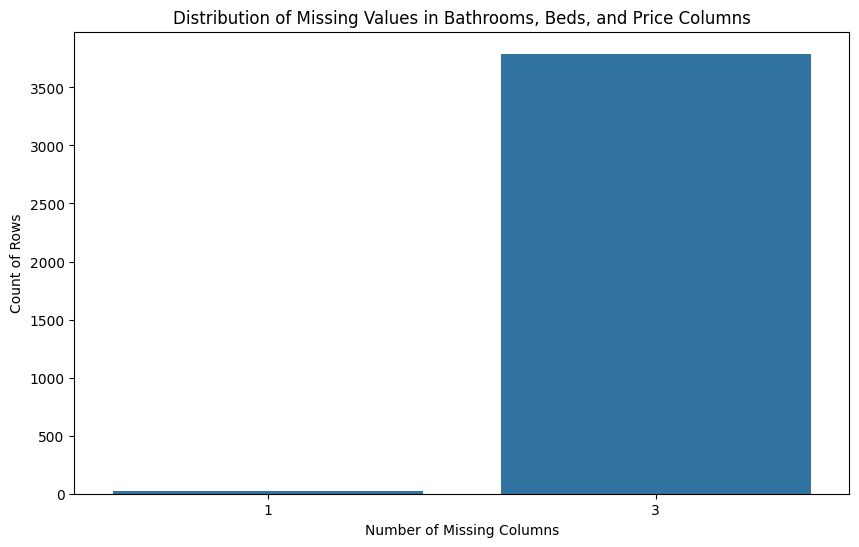

In [ ]:
# Create a new column to represent the number of missing values in the specified columns
listings_nan60['missing_count'] = listings_nan60[['bathrooms', 'beds', 'price']].isnull().sum(axis=1)

# Filter the dataframe to include only rows where at least one of the specified columns is missing
missing_data = listings_nan60[listings_nan60['missing_count'] > 0]

plt.figure(figsize=(10, 6))
sns.countplot(x='missing_count', data=missing_data)
plt.title('Distribution of Missing Values in Bathrooms, Beds, and Price Columns')
plt.xlabel('Number of Missing Columns')
plt.ylabel('Count of Rows')
plt.show()

We can see that the percentages of these columns are so similar because almost all missing values of these three columns come from the same rows.

Before deciding which strategy to follow, it is a good idea to search for another patterns in those rows. 

In [ ]:
#Print the rows with a missing_count of 3
missing_data[missing_data['missing_count'] == 3]['source'].value_counts()

source
previous scrape    3790
Name: count, dtype: int64

In [ ]:
listings['source'].value_counts()

source
city scrape        5869
previous scrape    3790
Name: count, dtype: int64

What I found is that all rows with all these 3 values missing have the value 'previous scrape' in the variable source. This might indicate that this information is no longer available, or that it is within another previous file. In both cases, for the moment, we will split the dataframe in 2, and we will continue with the 'clean' dataset. 


**UPDATE**: "One of "neighbourhood search" or "previous scrape". "neighbourhood search" means that the listing was found by searching the city, while "previous scrape" means that the listing was seen in another scrape performed in the last 65 days, and the listing was confirmed to be still available on the Airbnb site." --> Sacado de la documentación de la pagina. Como son de otra pagina, a tomar por culo.

In [ ]:
#Eliminate rows with a missing_count of 3
listings_clean = listings_nan60[listings_nan60['missing_count'] != 3]
listings_missing = listings_nan60[listings_nan60['missing_count'] == 3]
listings_clean.reset_index(inplace=True, drop=True)
listings_missing.reset_index(inplace=True, drop=True)

In [ ]:
listings_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5869 entries, 0 to 5868
Data columns (total 73 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            5869 non-null   int64  
 1   listing_url                                   5869 non-null   object 
 2   scrape_id                                     5869 non-null   int64  
 3   last_scraped                                  5869 non-null   object 
 4   source                                        5869 non-null   object 
 5   name                                          5869 non-null   object 
 6   description                                   5633 non-null   object 
 7   neighborhood_overview                         3171 non-null   object 
 8   picture_url                                   5869 non-null   object 
 9   host_id                                       5869 non-null   i

In [ ]:
#Remove the missing_count column
listings_clean.drop(columns='missing_count', inplace=True)


In [ ]:
missing_percentages_clean = missing_values_percentage(listings_clean, threshold=0)
print(missing_percentages_clean)

description                     4.021128
neighborhood_overview          45.970353
host_location                  12.523428
host_about                     45.817005
host_response_time             13.511671
host_response_rate             13.511671
host_acceptance_rate            5.861305
host_is_superhost               1.090475
neighbourhood                  45.970353
bathrooms                       0.017039
bathrooms_text                  0.136309
bedrooms                        0.102232
beds                            0.443006
has_availability                1.720906
first_review                   11.620378
last_review                    11.620378
review_scores_rating           11.620378
review_scores_accuracy         11.620378
review_scores_cleanliness      11.620378
review_scores_checkin          11.620378
review_scores_communication    11.620378
review_scores_location         11.620378
review_scores_value            11.620378
license                         1.192707
reviews_per_mont

In [ ]:
listings_clean.isnull().sum()['price']

0

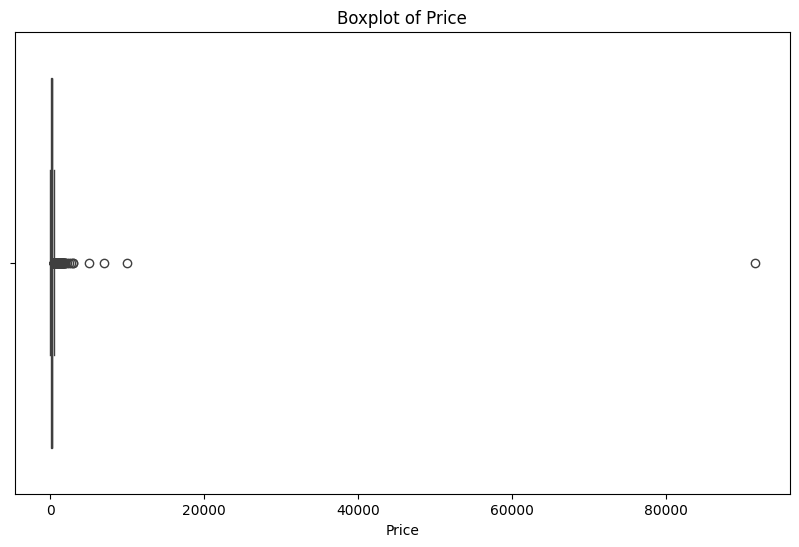

In [ ]:
#boxplot of the price column
plt.figure(figsize=(10, 6))
sns.boxplot(x='price', data=listings_clean)
plt.title('Boxplot of Price')
plt.xlabel('Price')
plt.show()


In [ ]:
listings_clean[['price', 'accommodates', 'bedrooms', 'beds', 'bathrooms']].isnull().sum()


price            0
accommodates     0
bedrooms         6
beds            26
bathrooms        1
dtype: int64

In [ ]:
listings_clean = remove_outliers(listings_clean, 'price')

In [ ]:
listings_clean[['price', 'accommodates', 'bedrooms', 'beds', 'bathrooms']].isnull().sum()


price            0
accommodates     0
bedrooms         6
beds            26
bathrooms        1
dtype: int64

Ahora, para valores numericos discretos vamos a seguir un metodo algo distinto (vamos a mirar primero las distribuciones para ver que pasa realmente)


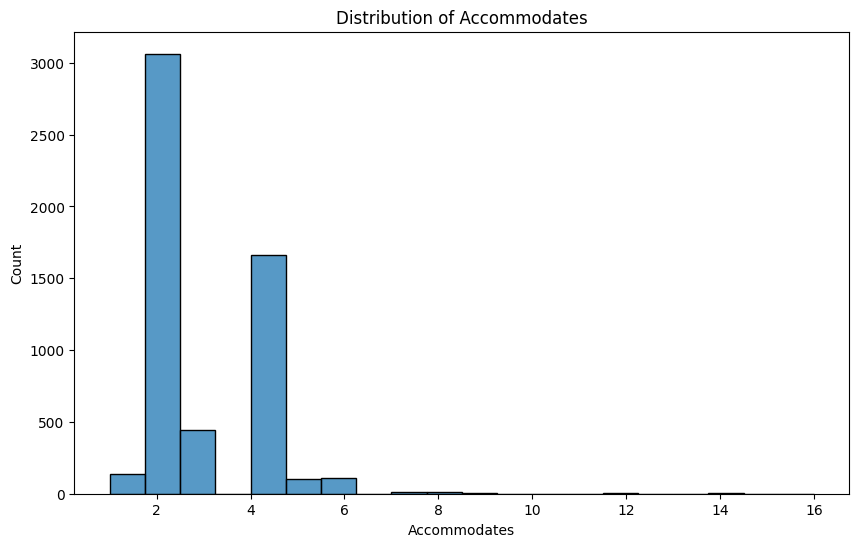

In [ ]:
#mirar distribucion de accomodates
plt.figure(figsize=(10, 6))
sns.histplot(listings_clean['accommodates'], bins=20)
plt.title('Distribution of Accommodates')
plt.xlabel('Accommodates')
plt.ylabel('Count')
plt.show()

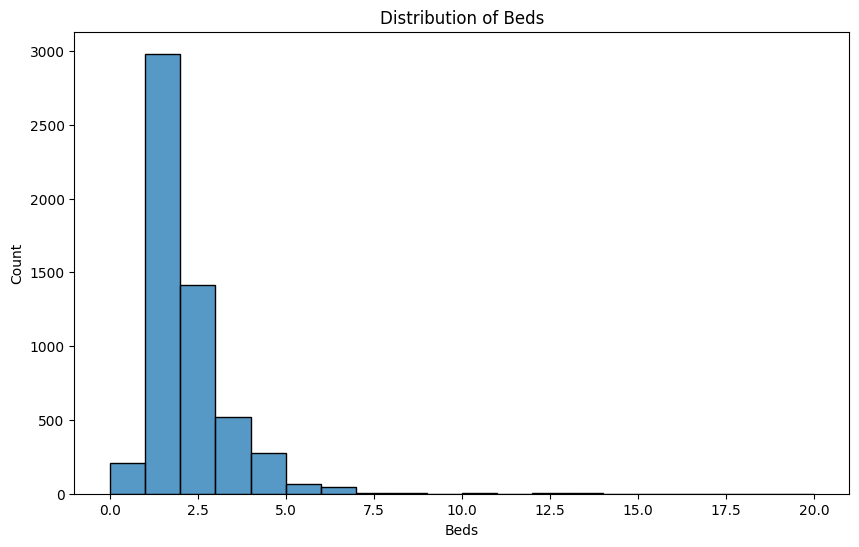

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(listings_clean['beds'], bins=20)
plt.title('Distribution of Beds')
plt.xlabel('Beds')
plt.ylabel('Count')
plt.show()

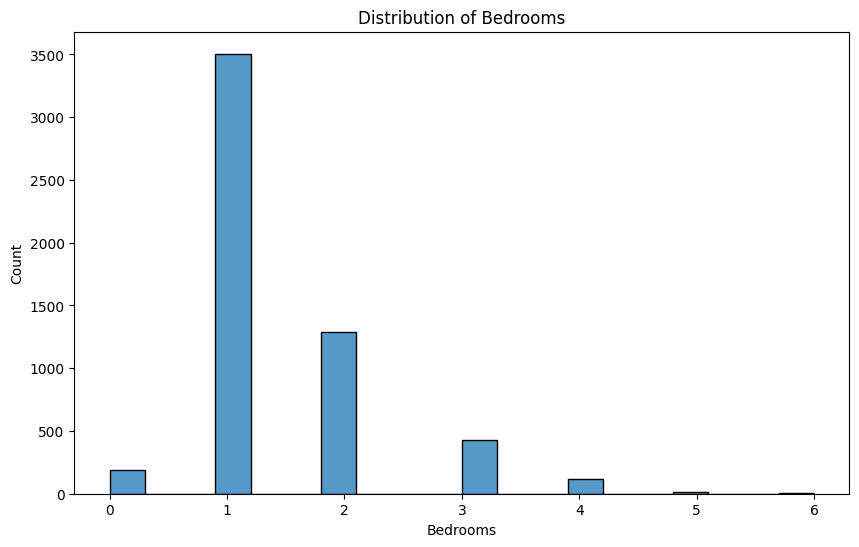

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(listings_clean['bedrooms'], bins=20)
plt.title('Distribution of Bedrooms')
plt.xlabel('Bedrooms')
plt.ylabel('Count')
plt.show()

In [ ]:
detect_outliers(listings_clean, ['accommodates','bedrooms', 'beds', 'bathrooms'])

{'accommodates': 26, 'bedrooms': 0, 'beds': 0, 'bathrooms': 0}

In [ ]:
listings_clean[['price', 'accommodates', 'bedrooms', 'beds', 'bathrooms']].isnull().sum()


price            0
accommodates     0
bedrooms         6
beds            26
bathrooms        1
dtype: int64

In [ ]:
listings_clean = remove_outliers(listings_clean, 'accommodates')
listings_clean = remove_outliers(listings_clean, 'bedrooms')
listings_clean = remove_outliers(listings_clean, 'bathrooms')
listings_clean.reset_index(inplace=True, drop=True)

In [ ]:
listings_clean[['price', 'accommodates', 'bedrooms', 'beds', 'bathrooms']].describe()


,price,accommodates,bedrooms,beds,bathrooms
count,5262.000000,5262.000000,5262.000000,5236.000000,5262.000000
mean,234.532117,2.741543,1.344546,1.572383,1.171418
std,104.499650,1.052915,0.660956,0.970586,0.283682
min,11.000000,1.000000,0.000000,0.000000,0.500000
25%,158.000000,2.000000,1.000000,1.000000,1.000000
50%,215.000000,2.000000,1.000000,1.000000,1.000000
75%,299.000000,4.000000,2.000000,2.000000,1.500000
max,555.000000,7.000000,3.000000,8.000000,2.000000


In [ ]:
listings_clean[['price', 'accommodates', 'bedrooms', 'beds', 'bathrooms']].isnull().sum()

price            0
accommodates     0
bedrooms         0
beds            26
bathrooms        0
dtype: int64

## KNN Imputation

In [ ]:
columns_for_imputation = [
    'latitude', 'longitude', 'neighbourhood_cleansed', 'property_type', 
    'room_type', 'price', 'accommodates', 'bedrooms', 'availability_30', 
    'availability_60', 'availability_90', 'availability_365', 
    'number_of_reviews', 'review_scores_rating', 
    'bathrooms', 'beds'
]

non_numeric_cols = ['neighbourhood_cleansed', 'property_type', 'room_type']

numeric_cols=['latitude', 'longitude', 'price', 'accommodates', 'bedrooms', 'availability_30', 
    'availability_60', 'availability_90', 'availability_365', 
    'number_of_reviews', 'review_scores_rating',
    'bathrooms', 'bedrooms', 'beds']

listings_imputation = listings_clean[columns_for_imputation]


Before applying KNN, we must perform some operations over the dataset. 

First, the non-numerical variables must be encoded. 

Then, it is recomended that numeric variables  are scaled, in order to have easier calculations, and to give all variables a similar importance in the imputation. 

In [ ]:
listings_imputation.isnull().sum()

latitude                    0
longitude                   0
neighbourhood_cleansed      0
property_type               0
room_type                   0
price                       0
accommodates                0
bedrooms                    0
availability_30             0
availability_60             0
availability_90             0
availability_365            0
number_of_reviews           0
review_scores_rating      606
bathrooms                   0
beds                       26
dtype: int64

In [ ]:

#Labelling encoding
label_encoders = {}
for col in non_numeric_cols:
    le = LabelEncoder()
    listings_imputation[col] = le.fit_transform(listings_imputation[col])
    label_encoders[col] = le





In [ ]:
listings_imputation.isnull().sum()

latitude                    0
longitude                   0
neighbourhood_cleansed      0
property_type               0
room_type                   0
price                       0
accommodates                0
bedrooms                    0
availability_30             0
availability_60             0
availability_90             0
availability_365            0
number_of_reviews           0
review_scores_rating      606
bathrooms                   0
beds                       26
dtype: int64

## Scaling and encoding

The most used scaling is the Standard Scaling. However, it assumes that the data has a normal distribution, so we must check if this is the case, and if not, find another method.

In [ ]:
#Check the normality of columns price, accomodates
stats, p = normaltest(listings_clean['price'])

print(p)

stats, p = normaltest(listings_clean['accommodates'])

print(p)

9.308038683299566e-84
3.0471653070464645e-109


Given that not all variables follow a normal distribution, we should not use Standard Scaling. Therefore, we will apply a Robust Scaling, which is less susceptible to outlier values than other techniques, while they do not affect the rest of the data as much as other methods. 

In [ ]:
# Apply Robust Scaler to numeric variables
scaler = RobustScaler()

listings_imputation[numeric_cols] = scaler.fit_transform(listings_imputation[numeric_cols])

In [ ]:
# Impute missing values
imputer = KNNImputer(n_neighbors=5)

listings_imputed = pd.DataFrame(imputer.fit_transform(listings_imputation), columns=listings_imputation.columns)

In [ ]:
listings_imputed.isnull().sum().sum()

0

In [ ]:
#Undo scaling and encoding
listings_imputed[numeric_cols] = scaler.inverse_transform(listings_imputed[numeric_cols])

for col in non_numeric_cols:
    le = label_encoders[col]
    listings_imputed[col] = le.inverse_transform(listings_imputed[col].astype(int))
    

In [ ]:
len(listings_clean)

5262

In [ ]:
listings_clean_backup = listings_clean.copy()

In [ ]:
listings_clean.update(listings_imputed)


In [ ]:
listings_clean[['accommodates', 'bedrooms', 'bathrooms', 'review_scores_rating']].isnull().sum()


accommodates            0
bedrooms                0
bathrooms               0
review_scores_rating    0
dtype: int64

## Feature engineering


In [ ]:
#Create two new columns to represent the ratio of accommodates per bedroom and per bed
listings_clean['accommodates_per_bedroom'] = listings_clean['accommodates'] / listings_clean['bedrooms']
listings_clean['accommodates_per_bed'] = listings_clean['accommodates'] / listings_clean['beds']
listings_clean['price_per_accommodate'] = listings_clean['price'] / listings_clean['accommodates']

In [ ]:
listings_clean[['accommodates', 'bedrooms', 'bathrooms', 'review_scores_rating']].isnull().sum()


accommodates            0
bedrooms                0
bathrooms               0
review_scores_rating    0
dtype: int64

In [ ]:
listings_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5262 entries, 0 to 5261
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            5262 non-null   int64  
 1   listing_url                                   5262 non-null   object 
 2   scrape_id                                     5262 non-null   int64  
 3   last_scraped                                  5262 non-null   object 
 4   source                                        5262 non-null   object 
 5   name                                          5262 non-null   object 
 6   description                                   5054 non-null   object 
 7   neighborhood_overview                         2797 non-null   object 
 8   picture_url                                   5262 non-null   object 
 9   host_id                                       5262 non-null   i

In [ ]:
detect_outliers(listings_clean, numeric_cols)

{'latitude': 246,
 'longitude': 210,
 'price': 55,
 'accommodates': 0,
 'bedrooms': 0,
 'availability_30': 0,
 'availability_60': 0,
 'availability_90': 0,
 'availability_365': 0,
 'number_of_reviews': 758,
 'review_scores_rating': 273,
 'bathrooms': 0,
 'beds': 268}

# Exploratory Data Analysis (EDA)

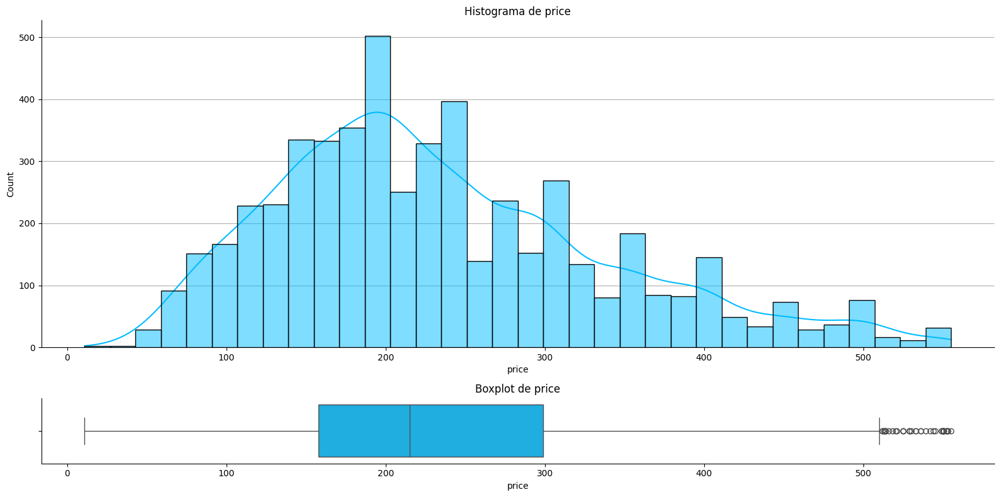

In [ ]:
f.numerical_simple(listings_clean, ['price'])

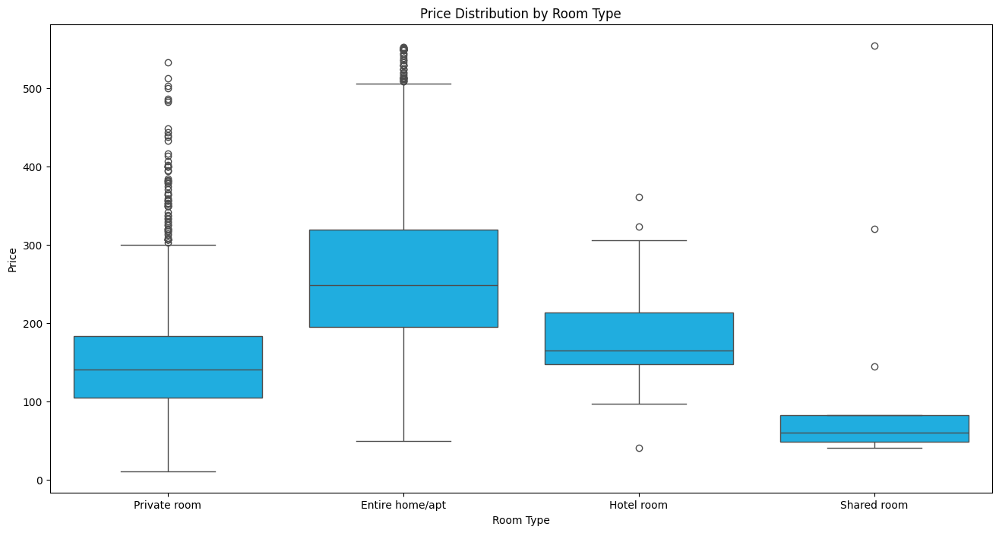

In [ ]:
#plot price according to roomtype

plt.figure(figsize=(16, 8))
sns.boxplot(x='room_type', y='price', data=listings_clean, color = '#00bcFF')
plt.title('Price Distribution by Room Type')
plt.xlabel('Room Type')
plt.ylabel('Price')
plt.show()


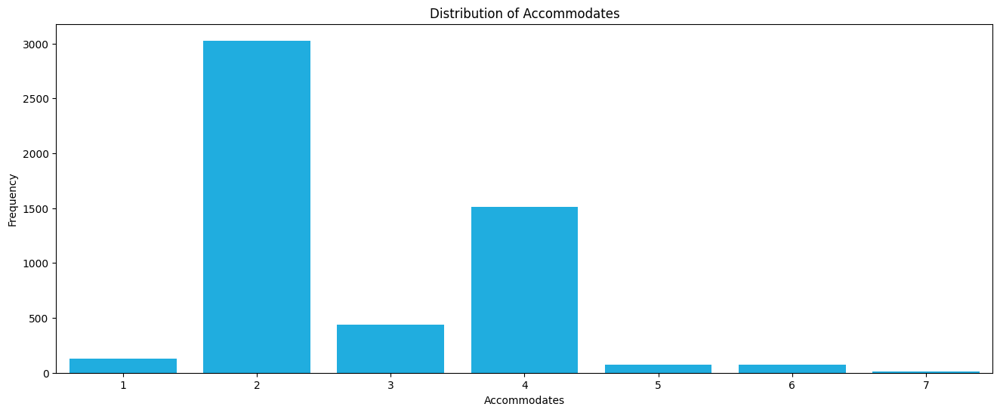

In [ ]:
#make a plot for the number of accomodates
plt.figure(figsize=(16, 6))
sns.countplot(x='accommodates', data=listings_clean, color = '#00bcFF')
plt.title('Distribution of Accommodates')
plt.xlabel('Accommodates')
plt.ylabel('Frequency')
plt.show()


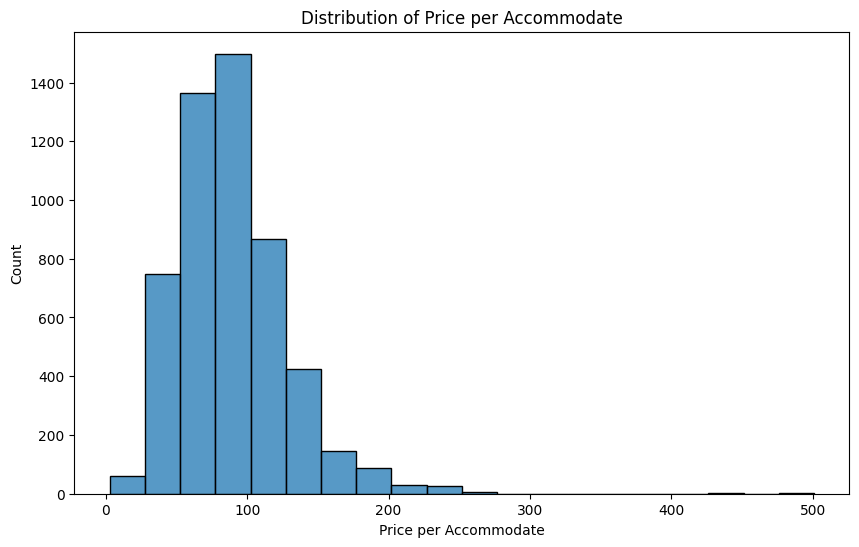

In [ ]:
#plot price_per_accommodate
plt.figure(figsize=(10, 6))
sns.histplot(listings_clean['price_per_accommodate'], bins=20)
plt.title('Distribution of Price per Accommodate')
plt.xlabel('Price per Accommodate')
plt.ylabel('Count')
plt.show()


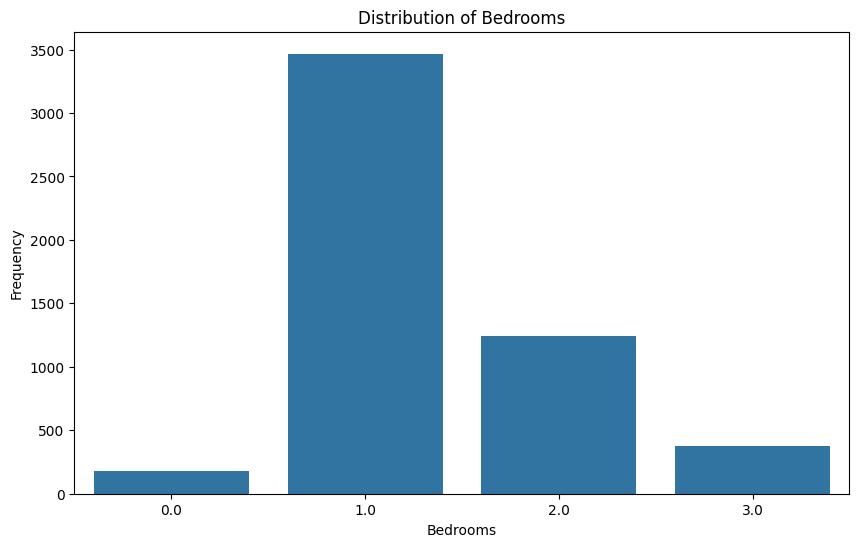

In [ ]:
#make a plot for the number of bedrooms
plt.figure(figsize=(10, 6))
sns.countplot(x='bedrooms', data=listings_clean)
plt.title('Distribution of Bedrooms')
plt.xlabel('Bedrooms')
plt.ylabel('Frequency')
plt.show()


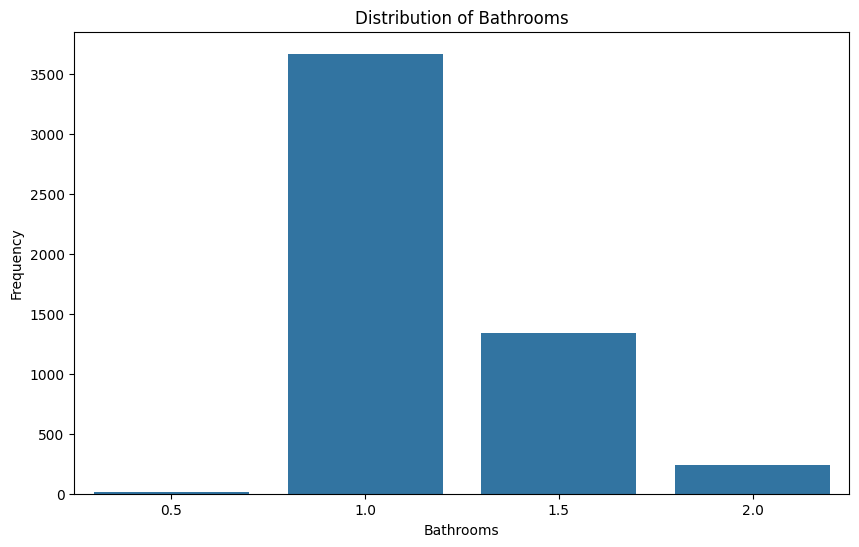

In [ ]:
#make a plot for the number of bathrooms
plt.figure(figsize=(10, 6))
sns.countplot(x='bathrooms', data=listings_clean)
plt.title('Distribution of Bathrooms')
plt.xlabel('Bathrooms')
plt.ylabel('Frequency')
plt.show()



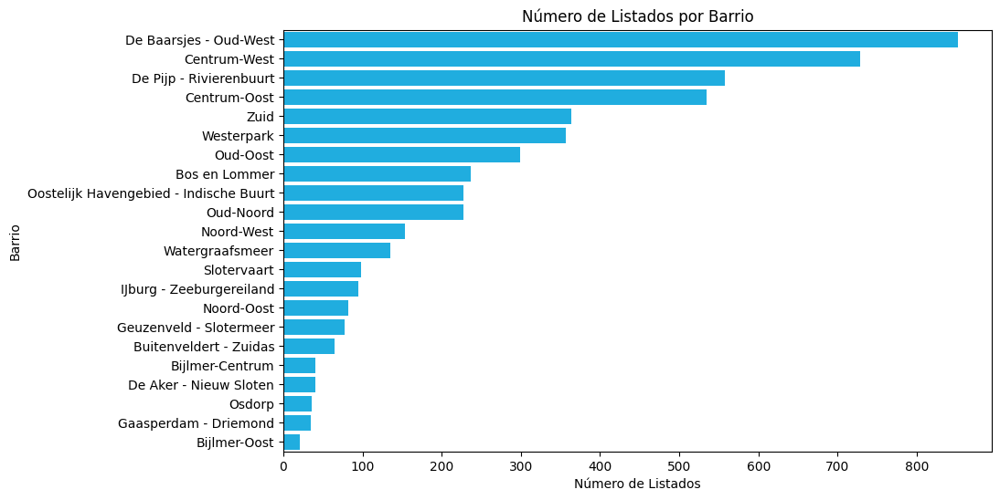

In [ ]:
#make a plot representing the number of listings per neighbourhood
plt.figure(figsize=(10, 6))
sns.countplot(y='neighbourhood_cleansed', data=listings_clean, 
              order=listings_clean['neighbourhood_cleansed'].value_counts().index, color='#00bcFF')
plt.title('Número de Listados por Barrio')
plt.xlabel('Número de Listados')
plt.ylabel('Barrio')
plt.show()


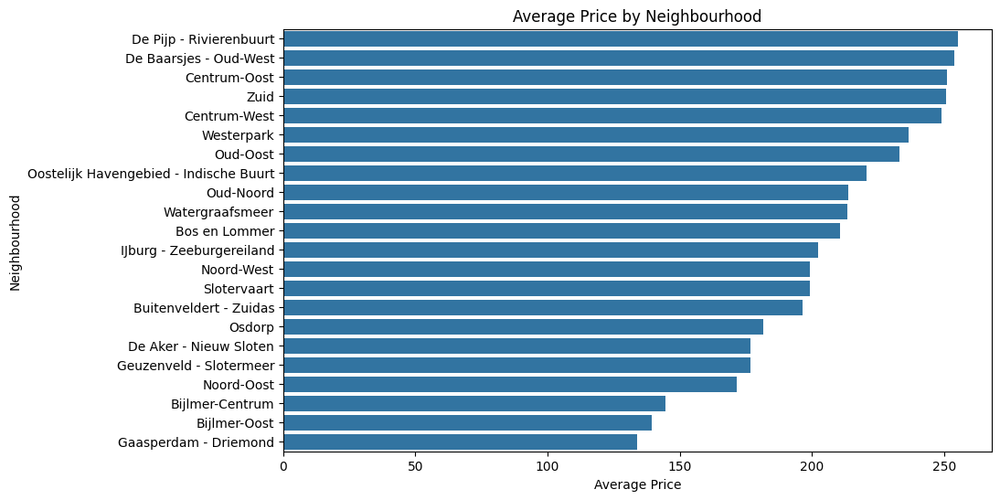

In [ ]:
#plot price according to neighbourhood
plt.figure(figsize=(10, 6))
sns.barplot(x='price', y='neighbourhood_cleansed', data=listings_clean, ci=None, estimator=np.mean, orient='h',
             order=listings_clean.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False).index)
plt.title('Average Price by Neighbourhood')
plt.xlabel('Average Price')
plt.ylabel('Neighbourhood')
plt.show()


In [ ]:
listings['host_id'].value_counts().head(10)

host_id
39110511     28
251479377    22
203731852    22
4456680      19
14574533     19
364305280    18
241644101    14
488984558    14
243878598    12
143098191    11
Name: count, dtype: int64

## Maps



In [ ]:

# Assuming you have a shapefile or GeoJSON file to read into gdf
gdf = gpd.read_file(r'data\neighbourhoods.geojson')

# Calculate mean price and point count for each neighbourhood
mean_price = listings_clean.groupby('neighbourhood_cleansed')['price'].mean().round(2)
point_count = listings_clean['neighbourhood_cleansed'].value_counts()

# Merge these statistics into the GeoDataFrame
gdf = gdf.merge(mean_price, left_on='neighbourhood', right_index=True, how='left')
gdf = gdf.merge(point_count.rename('point_count'), left_on='neighbourhood', right_index=True, how='left')

# Create scatter plot for individual flats, colored by price
fig = px.choropleth_mapbox(
    gdf,
    geojson=gdf.geometry,
    locations=gdf.index,
    color="neighbourhood",
    mapbox_style="carto-positron",
    center={"lat": gdf.geometry.centroid.y.mean(), "lon": gdf.geometry.centroid.x.mean()},
    zoom=10,
    opacity=0.5,
    hover_name="neighbourhood",
    hover_data={"price": True, "point_count": True}  # Add mean price and point count to hover data
)

scatter_fig = px.scatter_mapbox(
    listings_clean,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    hover_data=["price", 'accommodates', "neighbourhood_cleansed", "bathrooms", "bedrooms", "property_type", 
                "room_type", 'review_scores_rating'],
    color="price_per_accommodate",
    color_continuous_scale=px.colors.sequential.Bluered,
    center={"lat": listings_clean["latitude"].mean(), "lon": listings_clean["longitude"].mean()},
    zoom=8,
    size_max=4  
)

# Integrate scatter plot into the existing figure
for trace in scatter_fig.data:
    fig.add_trace(trace)
    # Update layout
    fig.update_layout(
        showlegend=False  
    )
scatter_fig.update_layout(
    mapbox_style="carto-positron",
    margin={"r":0,"t":0,"l":0,"b":0},
    legend=dict(yanchor="bottom", y=0, xanchor="center", x=0.01)
)

# Show the plot
fig.show()


In [ ]:
# Assuming you have a shapefile or GeoJSON file to read into gdf
gdf = gpd.read_file(r'data\neighbourhoods.geojson')

# Calculate mean price and point count for each neighbourhood
mean_price = listings_clean.groupby('neighbourhood_cleansed')['price'].mean().round(2)
point_count = listings_clean['neighbourhood_cleansed'].value_counts()

# Merge these statistics into the GeoDataFrame
gdf = gdf.merge(mean_price, left_on='neighbourhood', right_index=True, how='left')
gdf = gdf.merge(point_count.rename('point_count'), left_on='neighbourhood', right_index=True, how='left')

# Create scatter plot for individual flats, colored by price
fig = px.choropleth_mapbox(
    gdf,
    geojson=gdf.geometry,
    locations=gdf.index,
    color="neighbourhood",
    mapbox_style="carto-positron",
    center={"lat": gdf.geometry.centroid.y.mean(), "lon": gdf.geometry.centroid.x.mean()},
    zoom=10,
    opacity=0.5,
    hover_name="neighbourhood",
    hover_data={"price": True, "point_count": True}  # Add mean price and point count to hover data
)

scatter_fig_price = px.scatter_mapbox(
    listings_clean,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    hover_data=["price", 'accommodates', "price_per_accommodate", "neighbourhood_cleansed", "bathrooms", "bedrooms", "property_type", 
                "room_type", 'review_scores_rating'],
    color="price",
    color_continuous_scale=px.colors.sequential.Bluered,
    center={"lat": listings_clean["latitude"].mean(), "lon": listings_clean["longitude"].mean()},
    zoom=8,
    size_max=4  
)

scatter_fig_accommodates = px.scatter_mapbox(
    listings_clean,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    hover_data=[ 'accommodates', "price", "price_per_accommodate", "neighbourhood_cleansed", "bathrooms", "bedrooms", "property_type", 
                "room_type", 'review_scores_rating'],
    color="accommodates",
    color_continuous_scale=px.colors.sequential.Bluered,
    center={"lat": listings_clean["latitude"].mean(), "lon": listings_clean["longitude"].mean()},
    zoom=8,
    size_max=4  
)

scatter_fig_review_scores = px.scatter_mapbox(
    listings_clean,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    hover_data=['review_scores_rating',"price", 'accommodates',"price_per_accommodate",  "neighbourhood_cleansed", "bathrooms", "bedrooms", "property_type", 
                "room_type"],
    color="review_scores_rating",
    color_continuous_scale=px.colors.sequential.Bluered,
    center={"lat": listings_clean["latitude"].mean(), "lon": listings_clean["longitude"].mean()},
    zoom=8,
    size_max=4  
)

scatter_fig_bedrooms = px.scatter_mapbox(
    listings_clean,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    hover_data=["bedrooms", "price", 'accommodates', "price_per_accommodate", "neighbourhood_cleansed", "bathrooms",  "property_type", 
                "room_type", 'review_scores_rating'],
    color="bedrooms",
    color_continuous_scale=px.colors.sequential.Bluered,
    center={"lat": listings_clean["latitude"].mean(), "lon": listings_clean["longitude"].mean()},
    zoom=8,
    size_max=4  
)

scatter_fig_price_per_accommodate = px.scatter_mapbox(
    listings_clean,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    hover_data=["price_per_accommodate", "price", 'accommodates',  "neighbourhood_cleansed", "bathrooms", "bedrooms", "property_type", 
                "room_type", 'review_scores_rating'],
    color="price_per_accommodate",
    color_continuous_scale=px.colors.sequential.Bluered,
    center={"lat": listings_clean["latitude"].mean(), "lon": listings_clean["longitude"].mean()},
    zoom=8,
    size_max=4  
)
# Integrate scatter plot into the existing figure
for trace in scatter_fig_price.data:
    fig.add_trace(trace)

# Update layout
fig.update_layout(
    title="Geographical Distribution of Individual Flats",
    mapbox_style="carto-positron",
    margin={"r":0,"t":0,"l":0,"b":0},
    legend=dict(yanchor="bottom", y=0, xanchor="center", x=0.01)
)

# Add dropdown menu
fig.update_layout(
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=[{"marker.color": [trace.marker.color for trace in scatter_fig_price.data]}],
                    label="Price",
                    method="restyle"
                ),
                dict(
                    args=[{"marker.color": [trace.marker.color for trace in scatter_fig_accommodates.data]}],
                    label="Accommodates",
                    method="restyle"
                ),
                dict(
                    args=[{"marker.color": [trace.marker.color for trace in scatter_fig_review_scores.data]}],
                    label="Review Ratio",
                    method="restyle"
                ),
                dict(
                    args=[{"marker.color": [trace.marker.color for trace in scatter_fig_bedrooms.data]}],
                    label="Bedrooms",
                    method="restyle"
                ),
                dict(
                    args=[{"marker.color": [trace.marker.color for trace in scatter_fig_price_per_accommodate.data]}],
                    label="Price per Accommodate",
                    method="restyle"
                ),
            ]),
            direction="down",
            showactive=True,
        ),
    ]
)

# Show the plot
fig.show()


In [ ]:
import folium
from branca.colormap import LinearColormap

adam = gpd.read_file(r'data\neighbourhoods.geojson')

# Ensure feq is defined before using it
feq = listings_clean.groupby('neighbourhood_cleansed')['price'].mean().reset_index()
feq = feq.rename(columns={'neighbourhood_cleansed': 'neighbourhood', 'price': 'avg_price'})

adam = pd.merge(adam, feq, on='neighbourhood', how='left')
adam.rename(columns= {"price":"avg_price"}, inplace= True)
adam.avg_price = adam.avg_price.round(decimals=2)
map_dict = adam.set_index('neighbourhood')['avg_price'].to_dict()

color_scale = LinearColormap(["yellow", "red"], vmin = min(map_dict.values()), vmax = max(map_dict.values()))

def get_color(feature):
    value = map_dict.get(feature['properties']['neighbourhood'])
    if value is not None:
        return color_scale(value)
    else:
        return 'grey'

map3 = folium.Map(location=[52.3680, 4.9036], zoom_start=11)
folium.GeoJson(data=adam,
               name='Amsterdam',
               tooltip=folium.features.GeoJsonTooltip(fields=['neighbourhood', 'avg_price'],
                                                      labels=True,
                                                      sticky=True),
               style_function= lambda feature: {
                   'fillColor': get_color(feature),
                   'color': 'black',
                   'weight': 1,
                   'dashArray': '5, 5',
                   'fillOpacity':0.9
                   },
               highlight_function=lambda feature: {'weight':3, 'fillColor': get_color(feature), 'fillOpacity': 0.8}).add_to(map3)

fig = px.choropleth_mapbox(feq, geojson=adam, featureidkey='properties.neighbourhood', locations="neighbourhood", color='avg_price',
                            color_continuous_scale="portland", title="Neighbourhoods in Amsterdam", zoom=10, hover_data=['neighbourhood', 'avg_price'],
                            mapbox_style="carto-positron", width=1000, height=750, center={"lat": 52.3680, "lon": 4.9036})


fig.update(layout_coloraxis_showscale=True)
fig.update_layout(paper_bgcolor="#1f2630", font_color="white", title_font_size=20, title_x=0.5)
fig.show()


In [ ]:
listings_exp = listings_clean[['id', 'host_id', 'latitude', 'longitude', 'neighbourhood_cleansed', 'property_type', 
                               'room_type', 'price', 'accommodates', 'bedrooms', 'amenities',  
                               'bathrooms', 'beds', 'review_scores_rating', 'accommodates_per_bedroom', 'accommodates_per_bed',
                                'price_per_accommodate', 'number_of_reviews', 'availability_30', 'availability_60', 'availability_90', 'availability_365']]


#convert price to int
listings_exp['price'] = listings_exp['price'].astype(int)

listings_exp.to_csv(r'data\Processed\listings_clean.csv', index=False)

In [ ]:
listings_clean['price_per_accommodate']

0        89.666667
1        63.500000
2        50.750000
3        93.750000
4        54.500000
           ...    
5257    150.000000
5258     41.666667
5259     65.333333
5260    102.250000
5261     87.250000
Name: price_per_accommodate, Length: 5262, dtype: float64

## Correlation Analysis

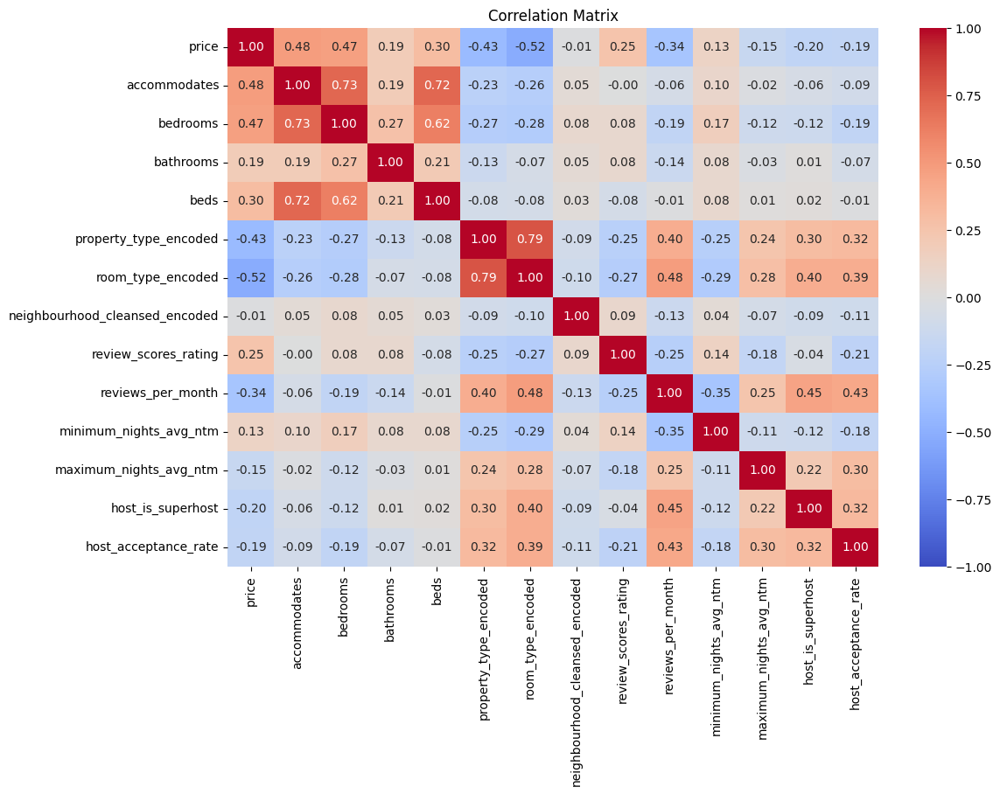

In [ ]:
#Make a correlation matrix

listings_corr = listings_clean[['price', 'accommodates', 'bedrooms', 'bathrooms', 'beds', 'property_type_encoded', 
                                 'room_type_encoded', 'neighbourhood_cleansed_encoded', 'review_scores_rating', 'reviews_per_month', 
                                 'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'host_is_superhost', 'host_acceptance_rate'
                                 ]].corr(method='spearman')

plt.figure(figsize=(12, 8))
sns.heatmap(listings_corr, annot=True, cmap='coolwarm', fmt=".2f", cbar=True, vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()



# Model construction 

## Encoding

In [ ]:
listings_clean[['accommodates', 'bedrooms', 'bathrooms', 'review_scores_rating']].isnull().sum()


accommodates            0
bedrooms                0
bathrooms               0
review_scores_rating    0
dtype: int64

In [ ]:
#Apply label encoding and save the encoding in a json file
label_encoder = LabelEncoder()

#Property type
listings_clean['property_type_encoded'] = label_encoder.fit_transform(listings_clean['property_type'])
property_type_encoding = {str(key): int(value) for key, value in zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_))}
with open(r'data\jsons\property_type_encoding.json', 'w') as f:
    json.dump(property_type_encoding, f)


#Room type
listings_clean['room_type_encoded'] = label_encoder.fit_transform(listings_clean['room_type'])
room_type_encoding = {str(key): int(value) for key, value in zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_))}
with open(r'data\jsons\room_type_encoding.json', 'w') as f:
    json.dump(room_type_encoding, f)


#Neighbourhood cleansed
listings_clean['neighbourhood_cleansed_encoded'] = label_encoder.fit_transform(listings_clean['neighbourhood_cleansed'])
neighbourhood_cleansed_encoding = {str(key): int(value) for key, value in zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_))}
with open(r'data\jsons\neighbourhood_cleansed_encoding.json', 'w') as f:
    json.dump(neighbourhood_cleansed_encoding, f)


In [ ]:
listings_clean[['accommodates', 'bedrooms', 'bathrooms', 'review_scores_rating']].isnull().sum()


accommodates            0
bedrooms                0
bathrooms               0
review_scores_rating    0
dtype: int64

## Scaling

In [ ]:
#Robust Scaler for the numerical columns
scaler = RobustScaler()

listings_clean_scaled = listings_clean.copy()

listings_clean_scaled[['accommodates', 'beds', 'bedrooms', 'bathrooms', 'review_scores_rating']] = (
    scaler.fit_transform(listings_clean[['accommodates', 'beds', 'bedrooms', 'bathrooms', 'review_scores_rating']]))



In [ ]:

#Feature selection
features = ['accommodates', 'bedrooms', 'bathrooms', 'beds', 'room_type_encoded', 'review_scores_rating', 'minimum_nights', 'maximum_nights']
target = 'price'

X = listings_clean_scaled[features]
y = listings_clean_scaled[target]


In [ ]:
listings_clean['room_type'].unique()

array(['Private room', 'Entire home/apt', 'Hotel room', 'Shared room'],
      dtype=object)

In [ ]:
#Outlier detection

detect_outliers(listings_clean, features + [target])

{'accommodates': 0,
 'bedrooms': 0,
 'bathrooms': 0,
 'beds': 268,
 'room_type_encoded': 0,
 'review_scores_rating': 273,
 'minimum_nights': 731,
 'maximum_nights': 909,
 'price': 55}

In [ ]:

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# Initialize the models
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42), 
    'SVR': SVR()
}

# Train the models
for name, model in models.items():
    model.fit(X_train, y_train)
    print(f"{name} model trained.")

# Evaluate the models
for name, model in models.items():
    y_pred = model.predict(X_test)
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    r2 = r2_score(y_test, y_pred)
    mape = mean_absolute_percentage_error(y_test, y_pred)
    print(f"{name} - MAE: {mae}, MSE: {mse}, RMSE: {rmse}, R2: {r2}, MAPE: {mape}")

# Select the best model based on MAE
best_model_name = None
best_model_score = float('inf')

for name, model in models.items():
    y_pred = model.predict(X_test)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    if rmse < best_model_score:
        best_model_score = rmse
        best_model_name = rmse

print(f"The best model is {best_model_name} with a RMSE of {best_model_score}.")


Linear Regression model trained.
Decision Tree model trained.
Random Forest model trained.
SVR model trained.
Linear Regression - MAE: 61.23817472524955, MSE: 6341.517020920005, RMSE: 79.63364251947795, R2: 0.42933738180281966, MAPE: 0.3314237963964062
Decision Tree - MAE: 80.76559040044033, MSE: 11782.480255795886, RMSE: 108.5471337981611, R2: -0.06028589207406965, MAPE: 0.40255253499747207
Random Forest - MAE: 63.15032648937788, MSE: 6914.857345558009, RMSE: 83.15562125050843, R2: 0.37774343516566644, MAPE: 0.33482191292039015
SVR - MAE: 81.95684402761279, MSE: 11302.55472873358, RMSE: 106.31347388141157, R2: -0.017098188420582527, MAPE: 0.45470786400218555
The best model is 79.63364251947795 with a RMSE of 79.63364251947795.


In [ ]:
#Make the model correctly

# Assuming listings_clean is your cleaned DataFrame
features = ['accommodates', 'bedrooms', 'bathrooms', 'beds', 'room_type_encoded', 'review_scores_rating']
target = 'price'

X = listings_clean[features]
y = listings_clean[target]


# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# Fit the scalers
feature_scaler = RobustScaler()
X_train_scaled = feature_scaler.fit_transform(X_train)
target_scaler = RobustScaler()
y_train_scaled = target_scaler.fit_transform(y_train.values.reshape(-1, 1))


# Train the Linear Regression model
model = LinearRegression()
model.fit(X_train_scaled, y_train_scaled)

# Save the model and scalers
joblib.dump(model, 'price_predictor_model.pkl')
joblib.dump(feature_scaler, 'feature_scaler.pkl')
joblib.dump(target_scaler, 'target_scaler.pkl')

['target_scaler.pkl']